In [22]:
import os
import mlflow
import pandas as pd
import numpy as np
from databricks import sql
from dotenv import load_dotenv

In [23]:
database = "olist_dataset"
goldSche=database+ ".gold"
lookupGeo=database+".silver"+ ".silver_olist_geolocation"
lookupCateName=database+".silver"+ ".silver_product_category_name_translation"
connection = sql.connect(
                        server_hostname = "dbc-214ffec4-c1f2.cloud.databricks.com",
                        http_path = "/sql/1.0/warehouses/8753fa7395d762fe",
                        access_token = os.environ.get("DATABRICKS_TOKEN"))

In [24]:
query=f"""
WITH 
-- 1. Lấy dữ liệu tương tác cốt lõi giữa User và Item
user_item_interactions AS (
    SELECT
        c.customer_unique_id,
        oi.product_key,
        COUNT(oi.order_id) AS purchase_count, -- Số lần user mua sản phẩm này
        SUM(oi.price) AS total_spent_on_product, -- Tổng tiền user chi cho sản phẩm này
        AVG(oi.price) AS avg_price_for_product,
        SUM(oi.freight_value) AS total_freight_on_product,
        MIN(d.full_date) AS first_purchase_date,
        MAX(d.full_date) AS last_purchase_date
    FROM {goldSche}.fact_order_items oi
    JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
    JOIN {goldSche}.dim_olist_orders o ON oi.order_key = o.order_key
    JOIN {goldSche}.dim_date d ON o.order_purchase_date_key = d.date_key
    GROUP BY c.customer_unique_id, oi.product_key
),

-- 2. Lấy điểm review (explicit feedback) cho từng cặp (user, item)
-- Giả định rằng review của một đơn hàng áp dụng cho tất cả sản phẩm trong đơn hàng đó.
product_reviews AS (
    SELECT 
        c.customer_unique_id,
        oi.product_key,
        AVG(r.score) AS avg_review_score_by_user -- Điểm review trung bình user dành cho sản phẩm
    FROM {goldSche}.fact_reviews r
    JOIN {goldSche}.fact_order_items oi ON r.order_key = oi.order_key
    JOIN {goldSche}.dim_olist_customers c ON r.customer_key = c.customer_key
    GROUP BY c.customer_unique_id, oi.product_key
),

-- 3. Xây dựng các feature tổng hợp cho mỗi User
user_features AS (
    SELECT
        c.customer_unique_id,
        COUNT(DISTINCT o.order_id) AS total_orders,
        SUM(oi.price) AS total_monetary,
        AVG(r.score) AS avg_overall_review_score, -- Điểm review trung bình của user trên mọi sản phẩm
        COUNT(DISTINCT p.product_category_name) AS distinct_categories_purchased,
        c.customer_city,
        c.customer_state
    FROM {goldSche}.fact_order_items oi
    JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
    JOIN {goldSche}.dim_olist_orders o ON oi.order_key = o.order_key
    JOIN {goldSche}.dim_olist_products p ON oi.product_key = p.product_key
    LEFT JOIN {goldSche}.fact_reviews r ON o.order_key = r.order_key
    GROUP BY c.customer_unique_id, c.customer_city, c.customer_state
),

-- 4. Xây dựng các feature tổng hợp cho mỗi Product (Item)
product_features AS (
    SELECT
        oi.product_key,
        AVG(oi.price) AS avg_product_price, -- Giá bán trung bình của sản phẩm
        COUNT(DISTINCT c.customer_unique_id) AS num_unique_purchasers, -- Số lượng người mua khác nhau
        COUNT(oi.order_id) AS total_sales_count, -- Tổng số lần được bán
        AVG(r.score) AS avg_product_review_score -- Điểm review trung bình của sản phẩm trên mọi user
    FROM {goldSche}.fact_order_items oi
    JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
    LEFT JOIN {goldSche}.fact_reviews r ON oi.order_key = r.order_key
    GROUP BY oi.product_key
)

-- 5. Kết hợp tất cả lại để tạo ra bảng phân tích cuối cùng
SELECT
    -- Interaction Keys
    uii.customer_unique_id,
    uii.product_key,
    p.product_category_name,

    -- Interaction Features (Implicit Feedback)
    uii.purchase_count,
    uii.total_spent_on_product,
    uii.avg_price_for_product,
    uii.total_freight_on_product,
    uii.first_purchase_date,
    uii.last_purchase_date,
    
    -- Explicit Feedback
    pr.avg_review_score_by_user,

    -- User Features
    uf.total_orders AS user_total_orders,
    uf.total_monetary AS user_total_monetary,
    uf.avg_overall_review_score AS user_avg_overall_review_score,
    uf.distinct_categories_purchased AS user_distinct_categories_purchased,
    uf.customer_city,
    uf.customer_state,
    
    -- Product (Item) Features
    pf.avg_product_price,
    pf.num_unique_purchasers AS product_num_unique_purchasers,
    pf.total_sales_count AS product_total_sales_count,
    pf.avg_product_review_score AS product_avg_review_score,
    p.product_weight_g,
    p.product_length_cm,
    p.product_height_cm,
    p.product_width_cm

FROM user_item_interactions uii
LEFT JOIN product_reviews pr ON uii.customer_unique_id = pr.customer_unique_id AND uii.product_key = pr.product_key
LEFT JOIN user_features uf ON uii.customer_unique_id = uf.customer_unique_id
LEFT JOIN product_features pf ON uii.product_key = pf.product_key
JOIN {goldSche}.dim_olist_products p ON uii.product_key = p.product_key
ORDER BY uii.customer_unique_id, uii.purchase_count DESC;
"""
df = pd.read_sql(query, connection)
df.describe()
df.info()

/tmp/ipykernel_7117/3744297083.py:109: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(query, connection)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100530 entries, 0 to 100529
Data columns (total 24 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   customer_unique_id                  100530 non-null  object 
 1   product_key                         100530 non-null  int64  
 2   product_category_name               100530 non-null  object 
 3   purchase_count                      100530 non-null  int64  
 4   total_spent_on_product              100530 non-null  float64
 5   avg_price_for_product               100530 non-null  float64
 6   total_freight_on_product            100530 non-null  float64
 7   first_purchase_date                 100530 non-null  object 
 8   last_purchase_date                  100530 non-null  object 
 9   avg_review_score_by_user            99259 non-null   float64
 10  user_total_orders                   100530 non-null  int64  
 11  user_total_monetary       

In [25]:
df[df['first_purchase_date']!= df['last_purchase_date']].head(50)

,customer_unique_id,product_key,product_category_name,purchase_count,total_spent_on_product,avg_price_for_product,total_freight_on_product,first_purchase_date,last_purchase_date,avg_review_score_by_user,...,customer_city,customer_state,avg_product_price,product_num_unique_purchasers,product_total_sales_count,product_avg_review_score,product_weight_g,product_length_cm,product_height_cm,product_width_cm
829,02168ea18740a0fdaaa15f11bebba5db,31115,moveis_decoracao,4,199.60,49.900000,64.44,2017-08-20,2017-10-09,3.000000,...,santa maria,RS,49.900000,19,35,3.600000,600.0,17.0,17.0,17.0
1153,02e9827c15167f699df7bf90d326ffdb,14909,utilidades_domesticas,2,45.98,22.990000,22.88,2018-03-04,2018-04-07,4.500000,...,sao bernardo do campo,SP,23.718667,14,15,4.200000,7350.0,25.0,62.0,25.0
2011,0509ab034845adb0b4c91b6f0e7b7260,7231,utilidades_domesticas,2,316.00,158.000000,23.46,2018-05-02,2018-05-04,5.000000,...,sao paulo,SP,158.000000,2,3,4.333333,11500.0,20.0,50.0,28.0
2130,055ec572ac7f3c7bdd04a183830ebe59,31952,automotivo,2,3999.98,1999.990000,53.10,2017-06-18,2017-07-18,1.000000,...,sao paulo,SP,1999.990000,10,11,1.181818,3000.0,35.0,20.0,30.0
2137,05669445931c028d97b7c0637b5a2359,1312,consoles_games,2,180.00,90.000000,30.78,2017-08-26,2017-10-07,5.000000,...,rio de janeiro,RJ,93.244545,10,11,4.545455,675.0,25.0,14.0,25.0
3049,07b1b60bca2b6326fa2adb259ea4a55f,1442,moveis_decoracao,2,131.80,65.900000,30.68,2018-03-30,2018-05-09,4.500000,...,porto alegre,RS,65.900000,1,2,4.500000,950.0,30.0,15.0,20.0
3176,07ff81a9676efa0286ddd3f09e7c0063,559,relogios_presentes,12,320.88,26.740000,163.44,2018-02-16,2018-06-11,3.000000,...,florianopolis,SC,27.345238,10,21,3.650000,567.0,26.0,12.0,26.0
3311,084be429c23e342acf5084ac6156d22e,15209,cama_mesa_banho,2,138.40,69.200000,39.43,2018-04-24,2018-07-22,4.500000,...,londrina,PR,69.870213,90,94,4.042553,950.0,45.0,15.0,35.0
3492,08c07c761592a71b85136aa4fe76a6f4,21248,beleza_saude,2,180.00,90.000000,34.14,2017-08-11,2018-01-26,5.000000,...,valente,BA,91.142857,3,7,3.142857,225.0,17.0,8.0,13.0
3801,0981a271500799427cdf345e9121e20b,15804,beleza_saude,2,129.98,64.990000,32.30,2017-04-03,2017-04-17,5.000000,...,sao gabriel,RS,60.002821,223,234,3.850220,200.0,22.0,10.0,18.0


In [26]:
connection.close()

In [27]:
# Xử lý các cột review bị thiếu
review_cols = ['avg_review_score_by_user', 'user_avg_overall_review_score', 'product_avg_review_score']

for col in review_cols:
    median_value = df[col].median()
    df[col].fillna(median_value, inplace=True)
    print(f"Đã điền các giá trị thiếu trong cột '{col}' bằng median: {median_value:.2f}")

# Xử lý các cột thuộc tính sản phẩm bị thiếu (chỉ có 1 dòng)
# Ta sẽ xóa các dòng có bất kỳ giá trị nào bị thiếu trong các cột này
product_physic_cols = ['product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm']
initial_rows = len(df)
df.dropna(subset=product_physic_cols, inplace=True)
rows_dropped = initial_rows - len(df)

print(f"\nĐã xóa {rows_dropped} dòng có giá trị thiếu ở thuộc tính vật lý của sản phẩm.")

Đã điền các giá trị thiếu trong cột 'avg_review_score_by_user' bằng median: 5.00
Đã điền các giá trị thiếu trong cột 'user_avg_overall_review_score' bằng median: 5.00
Đã điền các giá trị thiếu trong cột 'product_avg_review_score' bằng median: 4.17

Đã xóa 1 dòng có giá trị thiếu ở thuộc tính vật lý của sản phẩm.


/tmp/ipykernel_7117/502642219.py:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(median_value, inplace=True)
/tmp/ipykernel_7117/502642219.py:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'd

In [28]:
# Chuyển đổi các cột ngày tháng sang kiểu datetime
date_cols = ['first_purchase_date', 'last_purchase_date']

for col in date_cols:
    df[col] = pd.to_datetime(df[col])
    print(f"Đã chuyển đổi cột '{col}' sang kiểu datetime.")

# Kiểm tra lại kiểu dữ liệu của các cột này
print("\nKiểu dữ liệu sau khi chuyển đổi:")
print(df[date_cols].dtypes)

Đã chuyển đổi cột 'first_purchase_date' sang kiểu datetime.
Đã chuyển đổi cột 'last_purchase_date' sang kiểu datetime.

Kiểu dữ liệu sau khi chuyển đổi:
first_purchase_date    datetime64[ns]
last_purchase_date     datetime64[ns]
dtype: object


In [29]:
# Đếm số lượng dòng bị trùng lặp
duplicate_rows = df.duplicated().sum()
print(f"Tìm thấy {duplicate_rows} dòng dữ liệu bị trùng lặp.")

# Xóa các dòng bị trùng lặp nếu có
if duplicate_rows > 0:
    df.drop_duplicates(inplace=True)
    print("Đã xóa các dòng bị trùng lặp.")

Tìm thấy 0 dòng dữ liệu bị trùng lặp.


In [30]:
print("Thông tin tổng quan của DataFrame sau khi làm sạch:")
df.info()
print("\n" + "="*50 + "\n")

print("Dữ liệu sau khi làm sạch (5 dòng đầu):")
print(df.head())

Thông tin tổng quan của DataFrame sau khi làm sạch:
<class 'pandas.core.frame.DataFrame'>
Index: 100529 entries, 0 to 100529
Data columns (total 24 columns):
 #   Column                              Non-Null Count   Dtype         
---  ------                              --------------   -----         
 0   customer_unique_id                  100529 non-null  object        
 1   product_key                         100529 non-null  int64         
 2   product_category_name               100529 non-null  object        
 3   purchase_count                      100529 non-null  int64         
 4   total_spent_on_product              100529 non-null  float64       
 5   avg_price_for_product               100529 non-null  float64       
 6   total_freight_on_product            100529 non-null  float64       
 7   first_purchase_date                 100529 non-null  datetime64[ns]
 8   last_purchase_date                  100529 non-null  datetime64[ns]
 9   avg_review_score_by_user          

In [31]:
from ydata_profiling import ProfileReport
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 24/24 [00:00<00:00, 49.11it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [32]:
%matplotlib inline 
import matplotlib.pyplot as plt
import seaborn as sns

# Thiết lập style và context cho seaborn để biểu đồ đẹp hơn
sns.set_style("whitegrid")
sns.set_context("talk")

# Thiết lập một bảng màu chung
custom_palette = sns.color_palette("viridis", 15)
sns.set_palette(custom_palette)

print("Các thư viện đã được nhập và style biểu đồ đã được thiết lập.")

Các thư viện đã được nhập và style biểu đồ đã được thiết lập.


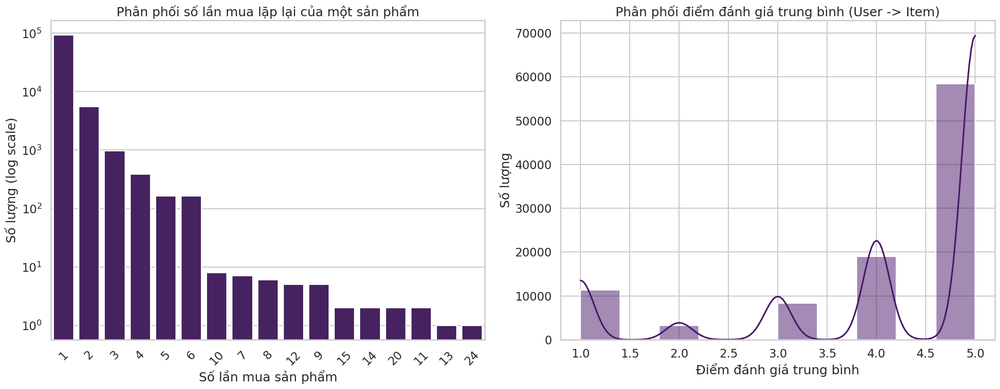

In [33]:
%matplotlib inline 
plt.figure(figsize=(20, 8))

# 1. Phân phối số lần một sản phẩm được mua bởi một người dùng (Purchase Count)
plt.subplot(1, 2, 1)
sns.countplot(x='purchase_count', data=df, order=df['purchase_count'].value_counts().index)
plt.title('Phân phối số lần mua lặp lại của một sản phẩm')
plt.xlabel('Số lần mua sản phẩm')
plt.ylabel('Số lượng (log scale)')
plt.yscale('log') # Sử dụng log scale vì dữ liệu rất lệch
plt.xticks(rotation=45)

# 2. Phân phối điểm đánh giá trung bình của người dùng cho sản phẩm
plt.subplot(1, 2, 2)
sns.histplot(df['avg_review_score_by_user'], bins=10, kde=True)
plt.title('Phân phối điểm đánh giá trung bình (User -> Item)')
plt.xlabel('Điểm đánh giá trung bình')
plt.ylabel('Số lượng')

plt.tight_layout()
plt.show()

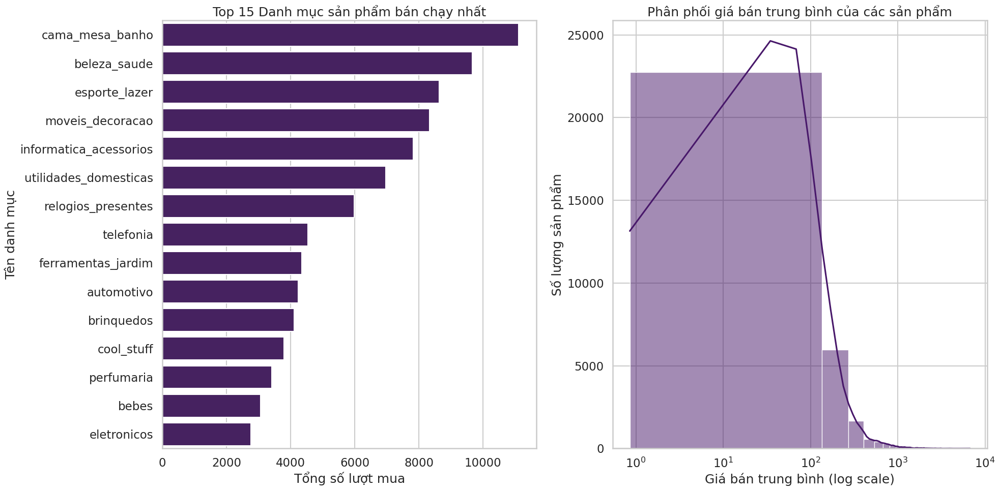

In [34]:
# Chuẩn bị dữ liệu cho phân tích sản phẩm (loại bỏ các sản phẩm trùng lặp)
product_df = df.drop_duplicates(subset=['product_key']).sort_values(by='product_total_sales_count', ascending=False)
category_df = df.groupby('product_category_name')['purchase_count'].sum().sort_values(ascending=False).reset_index()

plt.figure(figsize=(20, 10))

# 1. Top 15 danh mục sản phẩm phổ biến nhất
plt.subplot(1, 2, 1)
sns.barplot(y='product_category_name', x='purchase_count', data=category_df.head(15), orient='h')
plt.title('Top 15 Danh mục sản phẩm bán chạy nhất')
plt.xlabel('Tổng số lượt mua')
plt.ylabel('Tên danh mục')

# 2. Phân phối giá sản phẩm trung bình
plt.subplot(1, 2, 2)
sns.histplot(product_df['avg_product_price'], bins=50, kde=True)
plt.title('Phân phối giá bán trung bình của các sản phẩm')
plt.xlabel('Giá bán trung bình (log scale)')
plt.ylabel('Số lượng sản phẩm')
plt.xscale('log') # Sử dụng log scale vì giá có khoảng dao động rất rộng

plt.tight_layout()
plt.show()

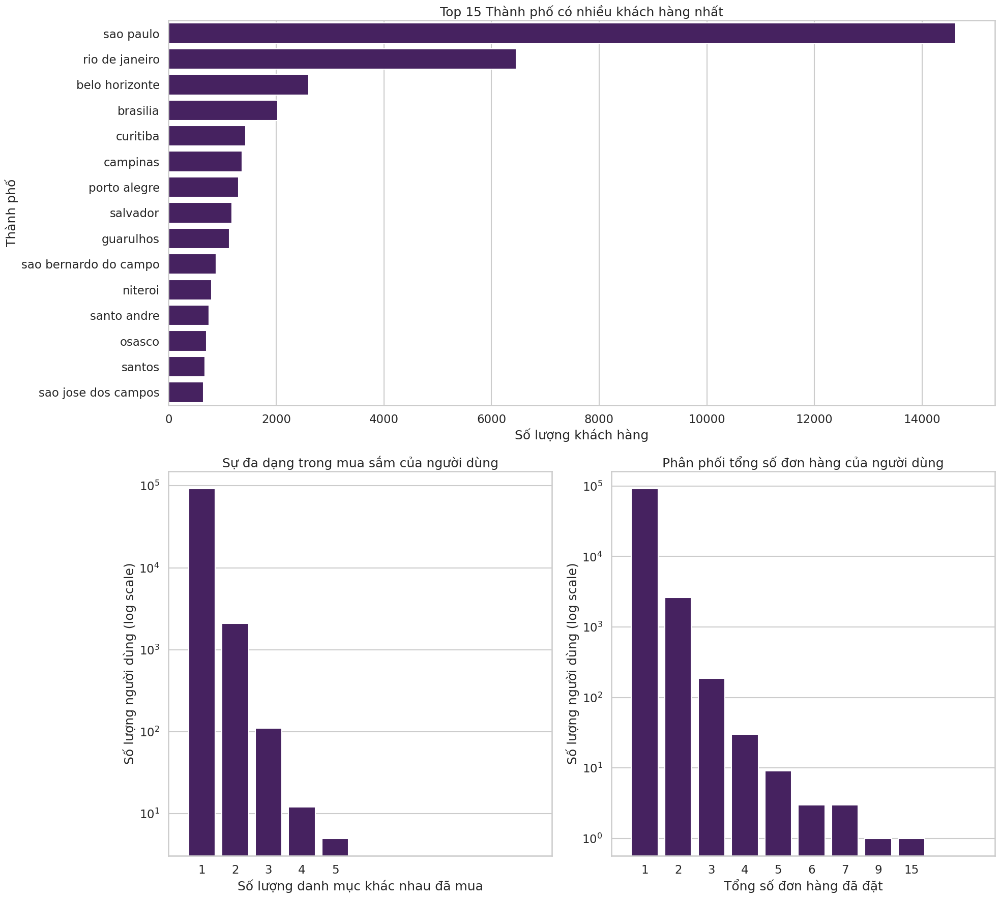

In [35]:
# Chuẩn bị dữ liệu cho phân tích người dùng
user_df = df.drop_duplicates(subset=['customer_unique_id'])

plt.figure(figsize=(20, 18))

# 1. Top 15 Thành phố có nhiều người dùng nhất
plt.subplot(2, 1, 1)
top_cities = user_df['customer_city'].value_counts().head(15)
sns.barplot(y=top_cities.index, x=top_cities.values, orient='h')
plt.title('Top 15 Thành phố có nhiều khách hàng nhất')
plt.xlabel('Số lượng khách hàng')
plt.ylabel('Thành phố')

# 2. Phân phối số lượng danh mục khác nhau mà người dùng đã mua
plt.subplot(2, 2, 3)
sns.countplot(x='user_distinct_categories_purchased', data=user_df, order=user_df['user_distinct_categories_purchased'].value_counts().index)
plt.title('Sự đa dạng trong mua sắm của người dùng')
plt.xlabel('Số lượng danh mục khác nhau đã mua')
plt.ylabel('Số lượng người dùng (log scale)')
plt.yscale('log')
plt.xlim(-1, 10.5) # Giới hạn trục x để dễ nhìn hơn

# 3. Phân phối tổng số đơn hàng của người dùng
plt.subplot(2, 2, 4)
sns.countplot(x='user_total_orders', data=user_df, order=user_df['user_total_orders'].value_counts().index)
plt.title('Phân phối tổng số đơn hàng của người dùng')
plt.xlabel('Tổng số đơn hàng đã đặt')
plt.ylabel('Số lượng người dùng (log scale)')
plt.yscale('log')
plt.xlim(-1, 10.5) # Giới hạn trục x để dễ nhìn hơn


plt.tight_layout()
plt.show()

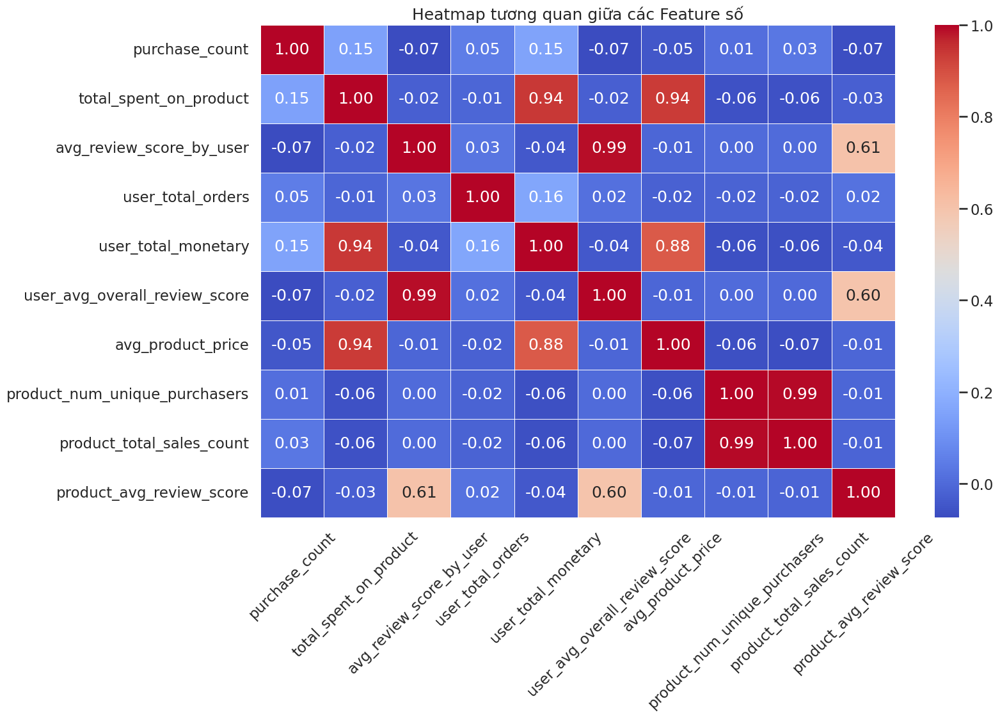

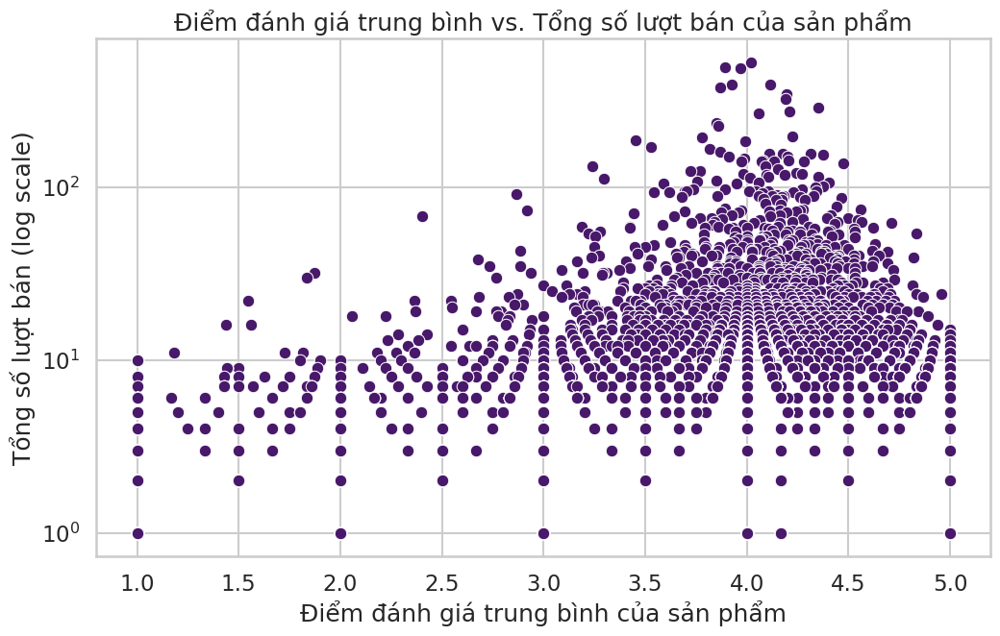

In [36]:
# Chọn các cột số quan trọng để vẽ heatmap
numeric_cols = [
    'purchase_count', 'total_spent_on_product', 'avg_review_score_by_user',
    'user_total_orders', 'user_total_monetary', 'user_avg_overall_review_score',
    'avg_product_price', 'product_num_unique_purchasers', 'product_total_sales_count',
    'product_avg_review_score'
]
corr_matrix = df[numeric_cols].corr()

plt.figure(figsize=(16, 10))

# 1. Heatmap tương quan
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=.5)
plt.title('Heatmap tương quan giữa các Feature số')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()


# 2. Mối quan hệ giữa điểm đánh giá trung bình và số lượt bán của sản phẩm
plt.figure(figsize=(12, 7))
sns.scatterplot(data=product_df, x='product_avg_review_score', y='product_total_sales_count')
plt.title('Điểm đánh giá trung bình vs. Tổng số lượt bán của sản phẩm')
plt.xlabel('Điểm đánh giá trung bình của sản phẩm')
plt.ylabel('Tổng số lượt bán (log scale)')
plt.yscale('log')
plt.show()

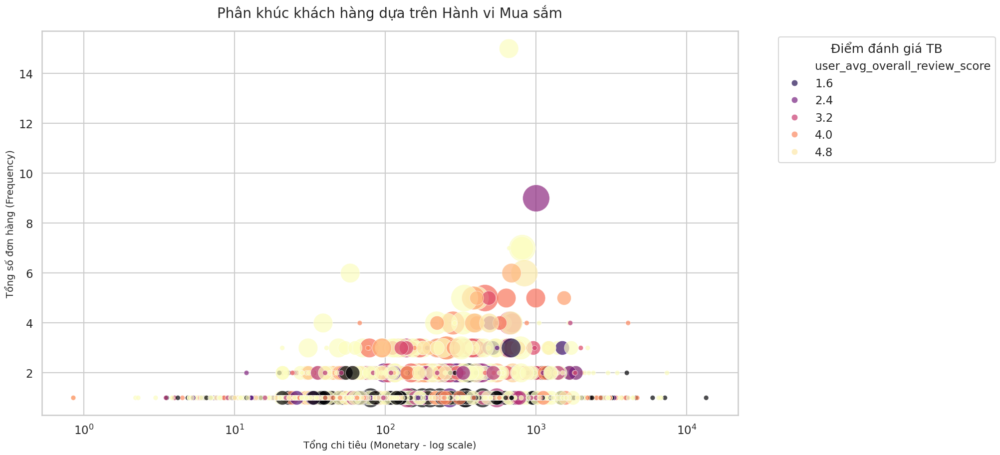

In [37]:
# Chuẩn bị dữ liệu người dùng độc nhất
user_df = df.drop_duplicates(subset=['customer_unique_id'])

# Thiết lập biểu đồ
plt.figure(figsize=(18, 10))
scatter = sns.scatterplot(
    data=user_df,
    x='user_total_monetary',
    y='user_total_orders',
    hue='user_avg_overall_review_score',
    size='user_distinct_categories_purchased',
    sizes=(50, 1500),  # Điều chỉnh khoảng kích thước bong bóng
    alpha=0.7,         # Điều chỉnh độ trong suốt
    palette='magma'    # Chọn một bảng màu đẹp
)

# Tùy chỉnh biểu đồ
plt.xscale('log') # Dùng log scale vì chi tiêu rất lệch
plt.title('Phân khúc khách hàng dựa trên Hành vi Mua sắm', fontsize=20, pad=20)
plt.xlabel('Tổng chi tiêu (Monetary - log scale)', fontsize=14)
plt.ylabel('Tổng số đơn hàng (Frequency)', fontsize=14)

# Điều chỉnh legend
h, l = scatter.get_legend_handles_labels()
plt.legend(h[0:6], l[0:6], title='Điểm đánh giá TB', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

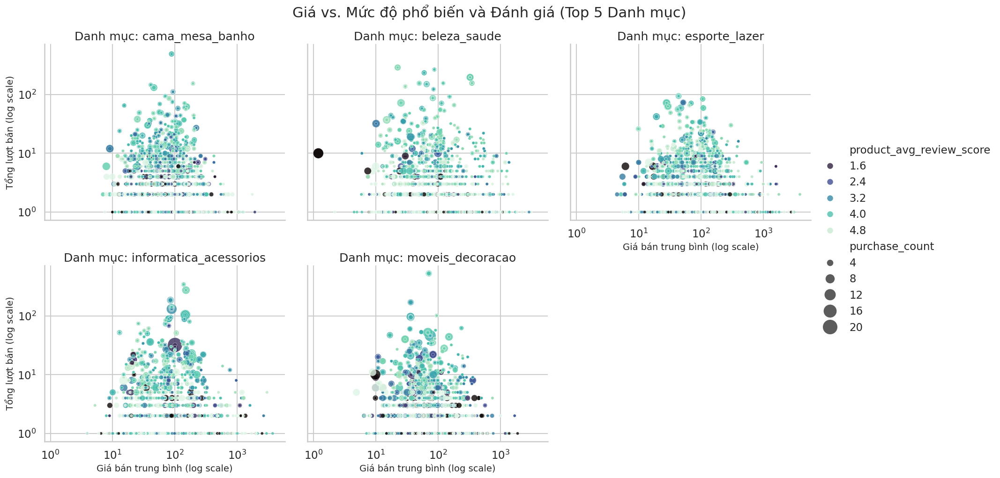

In [38]:
# Lấy top 5 danh mục phổ biến nhất
top_5_categories = df['product_category_name'].value_counts().nlargest(5).index
df_top5_cat = df[df['product_category_name'].isin(top_5_categories)]

# Sử dụng relplot để tạo biểu đồ phức hợp
g = sns.relplot(
    data=df_top5_cat,
    x='avg_product_price',
    y='product_total_sales_count',
    hue='product_avg_review_score',
    size='purchase_count',
    sizes=(20, 500),
    col='product_category_name', # Mỗi danh mục một cột
    col_wrap=3, # Số cột tối đa trên một hàng
    palette='mako',
    alpha=0.8,
    height=5,
    aspect=1.2
)

# Tùy chỉnh
g.fig.suptitle('Giá vs. Mức độ phổ biến và Đánh giá (Top 5 Danh mục)', y=1.03, fontsize=22)
g.set_axis_labels("Giá bán trung bình (log scale)", "Tổng lượt bán (log scale)", fontsize=14)
g.set_titles("Danh mục: {col_name}", fontsize=16)
g.set(xscale="log", yscale="log") # Dùng log scale cho cả 2 trục
plt.show()

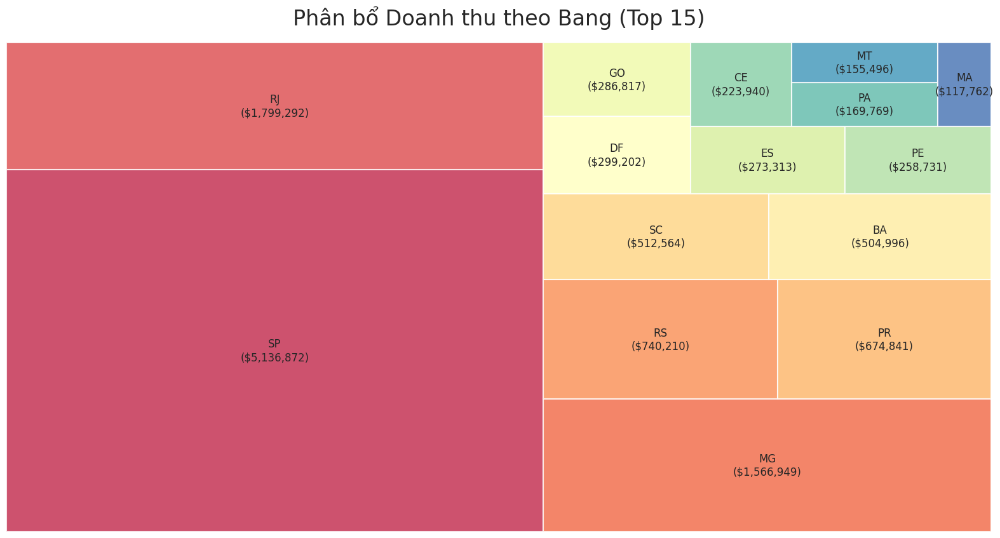

In [39]:


import squarify

# Chuẩn bị dữ liệu: Tính tổng chi tiêu theo từng Bang
state_monetary = df.groupby('customer_state')['total_spent_on_product'].sum().sort_values(ascending=False).reset_index()

# Lấy top 15 bang có doanh thu cao nhất
top_states = state_monetary.head(15)

# Tạo nhãn cho treemap
labels = [f'{state}\n(${total:,.0f})' for state, total in zip(top_states['customer_state'], top_states['total_spent_on_product'])]

# Vẽ treemap
plt.figure(figsize=(20, 10))
squarify.plot(
    sizes=top_states['total_spent_on_product'],
    label=labels,
    color=sns.color_palette("Spectral", len(top_states)),
    alpha=0.8,
    text_kwargs={'fontsize': 12}
)

plt.title('Phân bổ Doanh thu theo Bang (Top 15)', fontsize=24, pad=20)
plt.axis('off') # Tắt các trục tọa độ
plt.show()

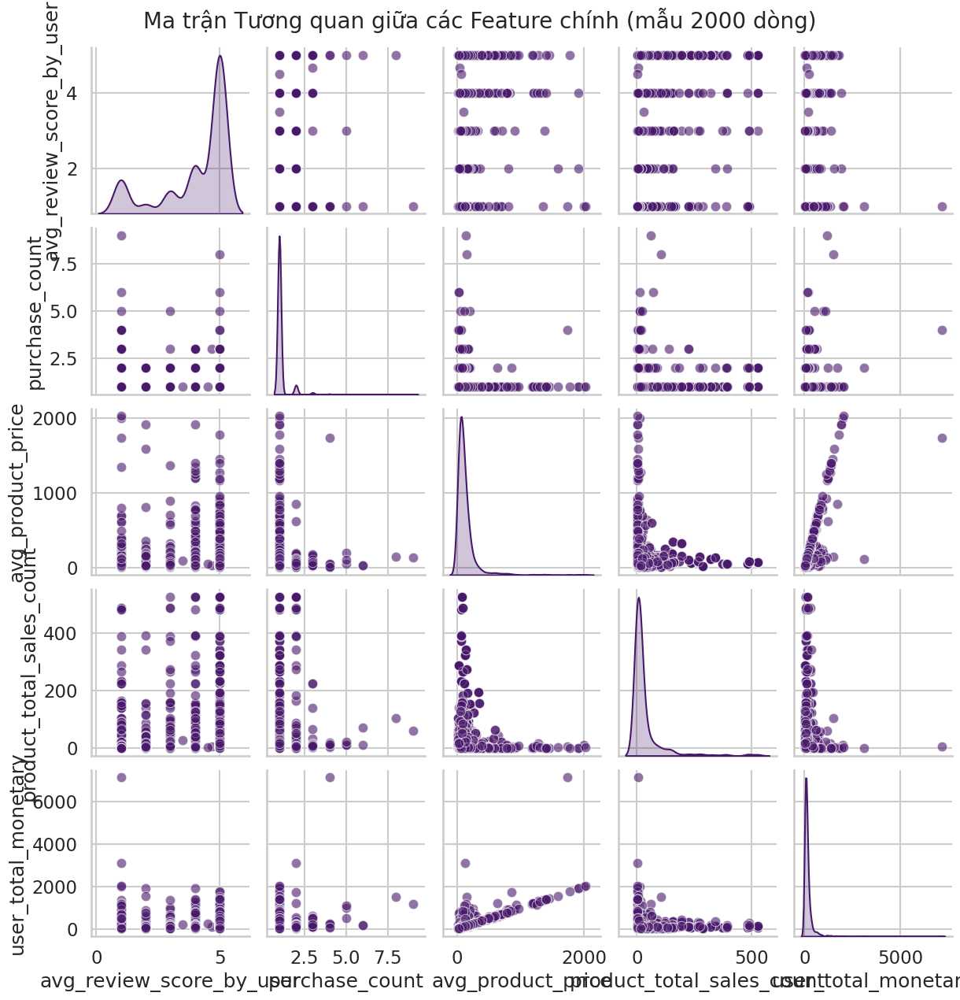

In [40]:
# Chọn một vài cột số tiêu biểu để phân tích
pairplot_cols = [
    'avg_review_score_by_user',
    'purchase_count',
    'avg_product_price',
    'product_total_sales_count',
    'user_total_monetary'
]

# Tạo một DataFrame nhỏ hơn để vẽ cho nhanh
df_pairplot = df[pairplot_cols].dropna().sample(n=2000, random_state=42) # Lấy mẫu 2000 dòng

# Vẽ pairplot
g = sns.pairplot(
    df_pairplot,
    diag_kind='kde', # Vẽ biểu đồ mật độ trên đường chéo
    plot_kws={'alpha': 0.6}
)

g.fig.suptitle('Ma trận Tương quan giữa các Feature chính (mẫu 2000 dòng)', y=1.02, fontsize=20)
plt.show()

In [1]:
import os
import mlflow
import pandas as pd
import numpy as np
from databricks import sql
from dotenv import load_dotenv
database = "olist_dataset"
goldSche=database+ ".gold"
lookupGeo=database+".silver"+ ".silver_olist_geolocation"
lookupCateName=database+".silver"+ ".silver_product_category_name_translation"
connection = sql.connect(
                        server_hostname = "dbc-214ffec4-c1f2.cloud.databricks.com",
                        http_path = "/sql/1.0/warehouses/8753fa7395d762fe",
                        access_token = os.environ.get("DATABRICKS_TOKEN"))


query_pro=f"""

WITH product_sales_aggregates AS (
    -- CTE 1: Tổng hợp các đặc tính từ dữ liệu bán hàng và tương tác cơ bản
    SELECT
        oi.product_key,
        COUNT(oi.order_id) AS total_sales_count, -- Tổng số lượt bán
        COUNT(DISTINCT c.customer_unique_id) AS num_unique_purchasers, -- Lượng khách hàng riêng biệt đã mua
        COUNT(DISTINCT oi.seller_key) AS num_sellers, -- Số lượng người bán khác nhau cho sản phẩm này
        
        -- Đặc tính về giá
        AVG(oi.price) AS avg_price, -- Giá bán trung bình
        STDDEV(oi.price) AS stddev_price, -- Độ lệch chuẩn của giá (cho thấy sự biến động giá)
        MIN(oi.price) AS min_price, -- Giá thấp nhất từng được bán
        MAX(oi.price) AS max_price, -- Giá cao nhất từng được bán

        -- Đặc tính về vận chuyển
        AVG(oi.freight_value) AS avg_freight_value, -- Phí vận chuyển trung bình
        AVG(oi.freight_value / NULLIF(oi.price, 0)) AS freight_to_price_ratio, -- Tỷ lệ phí vận chuyển trên giá

        -- Đặc tính về thời gian
        MIN(o.order_purchase_date_key) AS first_sale_date_key, -- Ngày bán đầu tiên
        MAX(o.order_purchase_date_key) AS last_sale_date_key -- Ngày bán gần nhất
    FROM {goldSche}.fact_order_items oi
    JOIN {goldSche}.dim_olist_orders o ON oi.order_key = o.order_key
    JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
    GROUP BY oi.product_key
),

product_review_aggregates AS (
    -- CTE 2: Tổng hợp các đặc tính từ dữ liệu review của khách hàng
    SELECT
        oi.product_key,
        AVG(r.score) AS avg_review_score, -- Điểm review trung bình
        STDDEV(r.score) AS stddev_review_score, -- Độ lệch chuẩn của điểm review
        COUNT(r.review_id) AS total_reviews_count, -- Tổng số lượng review
        
        -- Tỷ lệ review tích cực/tiêu cực (thường hữu ích hơn điểm trung bình)
        AVG(CASE WHEN r.score >= 4 THEN 1.0 ELSE 0.0 END) AS positive_review_ratio,
        AVG(CASE WHEN r.score <= 2 THEN 1.0 ELSE 0.0 END) AS negative_review_ratio
    FROM {goldSche}.fact_order_items oi
    JOIN {goldSche}.fact_reviews r ON oi.order_key = r.order_key
    GROUP BY oi.product_key
),

product_payment_aggregates AS (
    -- CTE 3: Tổng hợp các đặc tính từ phương thức thanh toán
    SELECT
        oi.product_key,
        AVG(fp.payment_installments) AS avg_payment_installments -- Số kỳ trả góp trung bình
    FROM {goldSche}.fact_order_items oi
    JOIN {goldSche}.fact_payments fp ON oi.order_key = fp.order_key
    GROUP BY oi.product_key
)

-- FINAL SELECT: Kết hợp tất cả các đặc tính lại
SELECT
    -- === A. Đặc tính nội dung tĩnh (Core Content Features) ===
    p.product_key,
    p.product_category_name,
    p.product_name_lenght,
    p.product_description_lenght,
    p.product_photos_qty,
    
    -- Đặc tính vật lý
    p.product_weight_g,
    p.product_length_cm,
    p.product_height_cm,
    p.product_width_cm,
    -- Feature tự tạo: Thể tích sản phẩm
    (p.product_length_cm * p.product_height_cm * p.product_width_cm) AS product_volume_cm3,

    -- === B. Đặc tính về sự phổ biến & Tương tác (Popularity & Interaction Features) ===
    COALESCE(psa.total_sales_count, 0) AS total_sales_count,
    COALESCE(psa.num_unique_purchasers, 0) AS num_unique_purchasers,
    -- Feature tự tạo: Tỷ lệ chuyển đổi (mua lại)
    (psa.total_sales_count / NULLIF(psa.num_unique_purchasers, 0)) AS repurchase_ratio,
    
    -- === C. Đặc tính về giá & Vận chuyển (Price & Shipping Features) ===
    COALESCE(psa.avg_price, 0) AS avg_price,
    COALESCE(psa.stddev_price, 0) AS stddev_price,
    COALESCE(psa.avg_freight_value, 0) AS avg_freight_value,
    COALESCE(psa.freight_to_price_ratio, 0) AS freight_to_price_ratio,

    -- === D. Đặc tính về Review & Sự hài lòng (Review & Satisfaction Features) ===
    COALESCE(pra.total_reviews_count, 0) AS total_reviews_count,
    COALESCE(pra.avg_review_score, 0) AS avg_review_score, -- Điểm trung bình có thể bị ảnh hưởng bởi vài review, nên dùng tỷ lệ bên dưới
    COALESCE(pra.stddev_review_score, 0) AS stddev_review_score, -- Độ lệch chuẩn cao cho thấy ý kiến trái chiều
    COALESCE(pra.positive_review_ratio, 0) AS positive_review_ratio,
    COALESCE(pra.negative_review_ratio, 0) AS negative_review_ratio,

    -- === E. Đặc tính về Bán hàng & Thanh toán (Seller & Payment Features) ===
    COALESCE(psa.num_sellers, 0) AS num_sellers,
    COALESCE(ppa.avg_payment_installments, 0) AS avg_payment_installments,

    -- === F. Đặc tính về Vòng đời sản phẩm (Lifecycle Features) ===
    psa.first_sale_date_key,
    psa.last_sale_date_key
    -- Bạn có thể tính toán 'tuổi' của sản phẩm ở bước sau bằng cách lấy ngày hiện tại trừ đi first_sale_date_key
    
FROM {goldSche}.dim_olist_products p
LEFT JOIN product_sales_aggregates psa ON p.product_key = psa.product_key
LEFT JOIN product_review_aggregates pra ON p.product_key = pra.product_key
LEFT JOIN product_payment_aggregates ppa ON p.product_key = ppa.product_key
WHERE p.product_category_name IS NOT NULL; -- Chỉ lấy các sản phẩm có danh mục rõ ràng
"""
df_pro = pd.read_sql(query_pro, connection)
df_pro.describe()
df_pro.info()



/tmp/ipykernel_1112/149066557.py:123: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_pro = pd.read_sql(query_pro, connection)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32341 entries, 0 to 32340
Data columns (total 26 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_key                 32341 non-null  int64  
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  int64  
 3   product_description_lenght  32341 non-null  int64  
 4   product_photos_qty          32341 non-null  int64  
 5   product_weight_g            32340 non-null  float64
 6   product_length_cm           32340 non-null  float64
 7   product_height_cm           32340 non-null  float64
 8   product_width_cm            32340 non-null  float64
 9   product_volume_cm3          32340 non-null  float64
 10  total_sales_count           32341 non-null  int64  
 11  num_unique_purchasers       32341 non-null  int64  
 12  repurchase_ratio            32341 non-null  float64
 13  avg_price                   323

In [2]:
query_cus=f"""

WITH unique_customers AS (
    -- CTE 0: Tạo bảng khách hàng duy nhất để làm gốc
    -- Chọn ra thông tin city, state từ bản ghi mới nhất của mỗi khách hàng
    SELECT
        customer_unique_id,
        customer_city,
        customer_state
    FROM (
        SELECT 
            *,
            ROW_NUMBER() OVER(PARTITION BY customer_unique_id ORDER BY customer_key DESC) as rn
        FROM {goldSche}.dim_olist_customers
    )
    WHERE rn = 1
),

customer_transactional_aggregates AS (
    -- CTE 1: Tổng hợp các đặc tính Giao dịch cốt lõi (RFM)
    SELECT
        c.customer_unique_id,
        COUNT(DISTINCT o.order_id) AS frequency,
        SUM(oi.price) AS monetary,
        MAX(d.full_date) AS last_purchase_date,
        MIN(d.full_date) AS first_purchase_date,
        COUNT(oi.product_key) AS total_items_purchased,
        SUM(oi.price) / COUNT(DISTINCT o.order_id) AS avg_value_per_order,
        COUNT(oi.product_key) / COUNT(DISTINCT o.order_id) AS avg_items_per_order,
        COUNT(DISTINCT oi.seller_key) AS distinct_sellers_count
    FROM {goldSche}.fact_order_items oi
    JOIN {goldSche}.dim_olist_orders o ON oi.order_key = o.order_key
    JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
    JOIN {goldSche}.dim_date d ON o.order_purchase_date_key = d.date_key
    GROUP BY c.customer_unique_id
),

customer_product_preferences AS (
    -- CTE 2: Phân tích sở thích về sản phẩm của khách hàng
    SELECT
        c.customer_unique_id,
        COUNT(DISTINCT p.product_category_name) AS distinct_categories_purchased,
        ARRAY_JOIN(
            TRANSFORM(
                SORT_ARRAY(COLLECT_LIST(STRUCT(o.order_purchase_date_key, p.product_category_name))),
                x -> x.product_category_name
            ), ' | '
        ) AS purchase_category_history
    FROM {goldSche}.fact_order_items oi
    JOIN {goldSche}.dim_olist_orders o ON oi.order_key = o.order_key
    JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
    JOIN {goldSche}.dim_olist_products p ON oi.product_key = p.product_key
    GROUP BY c.customer_unique_id
),

customer_favorite_category AS (
    -- CTE 3: Tìm danh mục sản phẩm yêu thích nhất
    SELECT DISTINCT customer_unique_id,
           FIRST_VALUE(product_category_name) OVER (PARTITION BY customer_unique_id ORDER BY category_count DESC) as favorite_category
    FROM (
        SELECT c.customer_unique_id, p.product_category_name, COUNT(*) as category_count
        FROM {goldSche}.fact_order_items oi
        JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
        JOIN {goldSche}.dim_olist_products p ON oi.product_key = p.product_key
        GROUP BY c.customer_unique_id, p.product_category_name
    )
),

customer_review_behavior AS (
    -- CTE 4: Phân tích hành vi đánh giá sản phẩm
    SELECT
        c.customer_unique_id,
        AVG(r.score) AS avg_review_score,
        COUNT(r.review_id) AS total_reviews_given
    FROM {goldSche}.fact_reviews r
    JOIN {goldSche}.dim_olist_customers c ON r.customer_key = c.customer_key
    GROUP BY c.customer_unique_id
),

customer_payment_behavior AS (
    -- CTE 5: Phân tích thói quen thanh toán
    SELECT
        c.customer_unique_id,
        AVG(fp.payment_installments) AS avg_payment_installments,
        MAX(fp.payment_installments) AS max_payment_installments,
        COUNT(DISTINCT fp.payment_type_key) AS distinct_payment_types_used
    FROM {goldSche}.fact_payments fp
    JOIN {goldSche}.dim_olist_orders o ON fp.order_key = o.order_key
    JOIN {goldSche}.dim_olist_customers c ON fp.customer_key = c.customer_key
    GROUP BY c.customer_unique_id
)

-- FINAL SELECT: Kết hợp tất cả lại, bắt đầu từ bảng khách hàng DUY NHẤT
SELECT
    c.customer_unique_id,
    c.customer_city,
    c.customer_state,
    COALESCE(cta.frequency, 0) AS total_orders,
    COALESCE(cta.monetary, 0) AS total_spent,
    COALESCE(cta.avg_value_per_order, 0) AS avg_value_per_order,
    DATEDIFF(CURRENT_DATE(), cta.last_purchase_date) AS days_since_last_purchase,
    DATEDIFF(cta.last_purchase_date, cta.first_purchase_date) AS customer_lifetime_days,
    DATEDIFF(cta.last_purchase_date, cta.first_purchase_date) / NULLIF(cta.frequency - 1, 0) AS avg_days_between_orders,
    COALESCE(cpp.distinct_categories_purchased, 0) AS distinct_categories_purchased,
    cfc.favorite_category,
    cpp.purchase_category_history,
    COALESCE(crb.avg_review_score, 0) AS avg_review_score_given,
    COALESCE(crb.total_reviews_given, 0) AS total_reviews_given,
    COALESCE(crb.total_reviews_given, 0) / NULLIF(cta.frequency, 0) AS review_propensity,
    COALESCE(cpb.avg_payment_installments, 1) AS avg_payment_installments,
    COALESCE(cpb.max_payment_installments, 1) AS max_payment_installments,
    COALESCE(cpb.distinct_payment_types_used, 0) AS distinct_payment_types_used
FROM unique_customers c 
LEFT JOIN customer_transactional_aggregates cta ON c.customer_unique_id = cta.customer_unique_id
LEFT JOIN customer_product_preferences cpp ON c.customer_unique_id = cpp.customer_unique_id
LEFT JOIN customer_favorite_category cfc ON c.customer_unique_id = cfc.customer_unique_id
LEFT JOIN customer_review_behavior crb ON c.customer_unique_id = crb.customer_unique_id
LEFT JOIN customer_payment_behavior cpb ON c.customer_unique_id = cpb.customer_unique_id;
"""
df_cus = pd.read_sql(query_cus, connection)
df_cus.describe()
df_cus.info()


/tmp/ipykernel_1112/1287940244.py:120: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_cus = pd.read_sql(query_cus, connection)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96096 entries, 0 to 96095
Data columns (total 18 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   customer_unique_id             96096 non-null  object 
 1   customer_city                  96096 non-null  object 
 2   customer_state                 96096 non-null  object 
 3   total_orders                   96096 non-null  int64  
 4   total_spent                    96096 non-null  float64
 5   avg_value_per_order            96096 non-null  float64
 6   days_since_last_purchase       95420 non-null  float64
 7   customer_lifetime_days         95420 non-null  float64
 8   avg_days_between_orders        2913 non-null   float64
 9   distinct_categories_purchased  96096 non-null  int64  
 10  favorite_category              94108 non-null  object 
 11  purchase_category_history      94108 non-null  object 
 12  avg_review_score_given         96096 non-null 

In [3]:
query_lab=f"""
-- Bảng tương tác để huấn luyện mô hình dự đoán sự hài lòng
-- Label: avg_review_score_by_user
-- Sample Weight: purchase_count

SELECT
    c.customer_unique_id,
    oi.product_key,
    
    -- Dùng cột này làm LABEL (y) cho mô hình.
    -- Đây là biến mục tiêu mà mô hình sẽ cố gắng dự đoán.
    AVG(r.score) AS avg_review_score_by_user,
    
    -- Dùng cột này làm SAMPLE_WEIGHT để cho mô hình biết độ quan trọng của từng mẫu.
    COUNT(oi.order_id) as purchase_count
    
FROM {goldSche}.fact_reviews r
-- Join với fact_order_items để lấy được product_key
JOIN {goldSche}.fact_order_items oi ON r.order_key = oi.order_key
-- Join với dim_customers để lấy customer_unique_id
JOIN {goldSche}.dim_olist_customers c ON r.customer_key = c.customer_key
-- Chỉ lấy các tương tác có review để làm target
GROUP BY c.customer_unique_id, oi.product_key
HAVING AVG(r.score) IS NOT NULL;
"""
df_lab = pd.read_sql(query_lab, connection)
df_lab.describe()
df_lab.info()


/tmp/ipykernel_1112/2961196831.py:26: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_lab = pd.read_sql(query_lab, connection)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100684 entries, 0 to 100683
Data columns (total 4 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   customer_unique_id        100684 non-null  object 
 1   product_key               99259 non-null   float64
 2   avg_review_score_by_user  100684 non-null  float64
 3   purchase_count            100684 non-null  int64  
dtypes: float64(2), int64(1), object(1)
memory usage: 3.1+ MB


In [4]:
df_cus.groupby('customer_unique_id').agg({'total_spent': 'sum'}).sort_values('total_spent', ascending=False).count()

total_spent    96096
dtype: int64

In [5]:
df_lab.head()

,customer_unique_id,product_key,avg_review_score_by_user,purchase_count
0,4987996ddcd0ddb20740fdce7c2bfbb1,17765.0,5.0,1
1,f99edeaa8a00f9866fd8fce5a0b83d4f,3190.0,5.0,1
2,457626c51309d814c33966c88a161545,28252.0,5.0,1
3,fdfa1cc68f121149d8fcc27ee96e134c,14445.0,5.0,1
4,0c35f915ac95c942a535a99bc22524a8,31693.0,5.0,1


In [6]:
df_cus.head()

,customer_unique_id,customer_city,customer_state,total_orders,total_spent,avg_value_per_order,days_since_last_purchase,customer_lifetime_days,avg_days_between_orders,distinct_categories_purchased,favorite_category,purchase_category_history,avg_review_score_given,total_reviews_given,review_propensity,avg_payment_installments,max_payment_installments,distinct_payment_types_used
0,0000f6ccb0745a6a4b88665a16c9f078,belem,PA,1,25.99,25.99,2912.0,0.0,NaN,1,telefonia,telefonia,4.0,1,1.0,4.0,4,1
1,0004aac84e0df4da2b147fca70cf8255,sorocaba,SP,1,180.00,180.00,2879.0,0.0,NaN,1,telefonia,telefonia,5.0,1,1.0,6.0,6,1
2,000d460961d6dbfa3ec6c9f5805769e1,sao paulo,SP,1,28.90,28.90,2825.0,0.0,NaN,1,telefonia,telefonia,5.0,1,1.0,1.0,1,1
3,000ec5bff359e1c0ad76a81a45cb598f,salto de pirapora,SP,1,14.96,14.96,2599.0,0.0,NaN,1,eletrodomesticos,eletrodomesticos,5.0,1,1.0,1.0,1,1
4,000fbf0473c10fc1ab6f8d2d286ce20c,indaiatuba,SP,1,285.80,285.80,2625.0,0.0,NaN,2,brinquedos,brinquedos | brinquedos | instrumentos_musicai...,5.0,1,1.0,1.0,1,1


In [7]:
# import pandas as pd
# import numpy as np
# import torch
# from torch.utils.data import Dataset, DataLoader
# from sklearn.preprocessing import StandardScaler, LabelEncoder
# # Bỏ import từ tensorflow.keras
# # from tensorflow.keras.preprocessing.sequence import pad_sequences
# import torch.nn.utils.rnn as rnn_utils # Import hàm pad_sequence của PyTorch

# # =============================================================================
# # BƯỚC 1: HÀM TỰ ĐỘNG PHÂN LOẠI FEATURE (Giữ nguyên)
# # =============================================================================
# def get_feature_lists(df, id_col, exclude_cols=None):
#     # ... (Hàm này giữ nguyên như cũ, không có gì liên quan đến TensorFlow)
#     if exclude_cols is None:
#         exclude_cols = []
#     numerical_features, categorical_features = [], []
#     for col in df.columns:
#         if col == id_col or col in exclude_cols:
#             continue
#         if df[col].dtype == 'object' or pd.api.types.is_categorical_dtype(df[col]):
#             categorical_features.append(col)
#         elif pd.api.types.is_numeric_dtype(df[col]):
#             if df[col].nunique() < 30 and df[col].dtype != 'float64':
#                 categorical_features.append(col)
#             else:
#                 numerical_features.append(col)
#     return numerical_features, categorical_features

# # =============================================================================
# # BƯỚC 2: CẬP NHẬT LẠI DATASET CLASS
# # Thay đổi: __getitem__ sẽ trả về chuỗi sequence chưa được pad.
# # =============================================================================
# class RecommenderDataset(Dataset):
#     """
#     Dataset class được cập nhật để trả về sequence chưa được pad.
#     """
#     def __init__(self, interactions_df, customers_df, products_df, 
#                  cust_num_feats, cust_cat_feats, cust_seq_feat,
#                  prod_num_feats, prod_cat_feats):
        
#         self.interactions = interactions_df
#         self.customers = customers_df.set_index('customer_unique_id')
#         self.products = products_df.set_index('product_key')
        
#         # Lưu lại danh sách các feature
#         self.cust_num_feats = cust_num_feats
#         self.cust_cat_feats = cust_cat_feats
#         self.cust_seq_feat = cust_seq_feat # Tên cột chứa sequence đã được tokenize
#         self.prod_num_feats = prod_num_feats
#         self.prod_cat_feats = prod_cat_feats

#     def __len__(self):
#         return len(self.interactions)

#     def __getitem__(self, idx):
#         interaction = self.interactions.iloc[idx]
#         customer_id = interaction['customer_unique_id']
#         product_id = int(interaction['product_key'])
        
#         label = torch.tensor(interaction['avg_review_score_by_user'], dtype=torch.float32)
#         sample_weight = torch.tensor(interaction['purchase_count'], dtype=torch.float32)
        
#         customer_row = self.customers.loc[customer_id]
#         cust_cat_tensor = torch.tensor([customer_row[col] for col in self.cust_cat_feats], dtype=torch.long)
#         cust_num_tensor = torch.tensor(customer_row[self.cust_num_feats].values.astype(np.float32), dtype=torch.float32)
#         # THAY ĐỔI: Trả về sequence chưa pad (dưới dạng list hoặc tensor)
#         cust_seq_tensor = torch.tensor(customer_row[self.cust_seq_feat], dtype=torch.long)
        
#         product_row = self.products.loc[product_id]
#         prod_cat_tensor = torch.tensor([product_row[col] for col in self.prod_cat_feats], dtype=torch.long)
#         prod_num_tensor = torch.tensor(product_row[self.prod_num_feats].values.astype(np.float32), dtype=torch.float32)
        
#         return {
#             'customer_cat': cust_cat_tensor,
#             'customer_num': cust_num_tensor,
#             'customer_seq': cust_seq_tensor, # Đây là tensor có độ dài thay đổi
#             'product_cat': prod_cat_tensor,
#             'product_num': prod_num_tensor,
#             'label': label,
#             'sample_weight': sample_weight
#         }

# # =============================================================================
# # BƯỚC 3: ĐỊNH NGHĨA HÀM `collate_fn` ĐỂ PAD THEO TỪNG BATCH
# # =============================================================================

# def collate_fn(batch):
#     """
#     Hàm tùy chỉnh để gộp một list các mẫu (từ __getitem__) thành một batch duy nhất.
#     Đây là nơi chúng ta sẽ thực hiện padding cho sequence.
#     """
#     # Tách các thành phần từ batch
#     batch_data = {key: [] for key in batch[0].keys()}
#     for sample in batch:
#         for key, value in sample.items():
#             batch_data[key].append(value)

#     # Dùng torch.stack cho các tensor có cùng kích thước
#     customer_cat = torch.stack(batch_data['customer_cat'])
#     customer_num = torch.stack(batch_data['customer_num'])
#     product_cat = torch.stack(batch_data['product_cat'])
#     product_num = torch.stack(batch_data['product_num'])
#     label = torch.stack(batch_data['label'])
#     sample_weight = torch.stack(batch_data['sample_weight'])

#     # DÙNG HÀM CỦA PYTORCH ĐỂ PAD SEQUENCE
#     # batch_data['customer_seq'] bây giờ là một list các tensor có độ dài khác nhau
#     customer_seq_padded = rnn_utils.pad_sequence(
#         batch_data['customer_seq'], 
#         batch_first=True, 
#         padding_value=0 # Giả sử 0 là giá trị padding
#     )

#     # Trả về batch cuối cùng
#     return {
#         'customer_cat': customer_cat,
#         'customer_num': customer_num,
#         'customer_seq': customer_seq_padded, # Sequence đã được pad
#         'product_cat': product_cat,
#         'product_num': product_num,
#         'label': label,
#         'sample_weight': sample_weight
#     }

# import torch
# import torch.nn as nn
# import math

# # =============================================================================
# # CẬP NHẬT CONFIG CHO MÔ HÌNH
# # =============================================================================
# model_config = {
#     'embedding_dim': 32,
#     'num_cust_numerical_feats': 13,
#     'num_prod_numerical_feats': 22,
#     'vocab_sizes': {
#         'customer_city': 4120,
#         'customer_state': 28,
#         'favorite_category': 74,
#         'product_category_name': 74,
#     },
#     'seq_vocab_size': 75,
#     'max_seq_len': 15, # Cần biết độ dài tối đa của chuỗi cho Positional Encoding
#     'dropout_rate': 0.1,
    
#     # === Thêm config cho Transformer ===
#     'transformer_nhead': 4,      # Số lượng attention heads (phải chia hết embedding_dim)
#     'transformer_nlayers': 2,    # Số lớp Transformer chồng lên nhau
#     'transformer_dim_feedforward': 64 # Kích thước lớp feed-forward bên trong
# }

# # =============================================================================
# # XÂY DỰNG PYTORCH MODEL CLASS VỚI TRANSFORMER
# # =============================================================================

# class ContentBasedRecommender(nn.Module):
#     def __init__(self, config):
#         super().__init__()
#         self.config = config
#         embedding_dim = self.config['embedding_dim']

#         # --- User Tower Layers ---
#         # 1. Embedding layers cho các feature categorical (giữ nguyên)
#         self.cust_city_embedding = nn.Embedding(config['vocab_sizes']['customer_city'], embedding_dim)
#         self.cust_state_embedding = nn.Embedding(config['vocab_sizes']['customer_state'], embedding_dim)
#         self.cust_fav_cat_embedding = nn.Embedding(config['vocab_sizes']['favorite_category'], embedding_dim)
        
#         # 2. Embedding layer cho chuỗi lịch sử mua hàng (giữ nguyên)
#         self.cust_seq_embedding = nn.Embedding(config['seq_vocab_size'], embedding_dim, padding_idx=0)
        
#         # ===  Transformer ===
#         # a. Positional Encoding để thêm thông tin vị trí vào chuỗi
#         self.positional_encoding = nn.Embedding(config['max_seq_len'], embedding_dim)
        
#         # b. Định nghĩa một lớp Transformer Encoder
#         encoder_layer = nn.TransformerEncoderLayer(
#             d_model=embedding_dim,
#             nhead=config['transformer_nhead'],
#             dim_feedforward=config['transformer_dim_feedforward'],
#             dropout=config['dropout_rate'],
#             batch_first=True # Rất quan trọng!
#         )
#         # c. Gom nhiều lớp encoder lại thành một khối
#         self.transformer_encoder = nn.TransformerEncoder(
#             encoder_layer,
#             num_layers=config['transformer_nlayers']
#         )
        
#         # 3. Mạng MLP cho feature số của user (giữ nguyên)
#         self.cust_numerical_mlp = nn.Sequential(
#             nn.Linear(config['num_cust_numerical_feats'], embedding_dim * 2),
#             nn.ReLU(),
#             nn.Dropout(config['dropout_rate']),
#             nn.Linear(embedding_dim * 2, embedding_dim)
#         )
        
#         # 4. Mạng MLP cuối cùng để gộp tất cả thông tin của user (giữ nguyên)
#         self.user_tower_mlp = nn.Sequential(
#             nn.Linear(embedding_dim * 5, embedding_dim * 2),
#             nn.ReLU(),
#             nn.Dropout(config['dropout_rate']),
#             nn.Linear(embedding_dim * 2, embedding_dim)
#         )

#         # --- Product Tower Layers (giữ nguyên) ---
#         self.prod_cat_embedding = nn.Embedding(config['vocab_sizes']['product_category_name'], embedding_dim)
#         self.prod_numerical_mlp = nn.Sequential(
#             nn.Linear(config['num_prod_numerical_feats'], embedding_dim * 2),
#             nn.ReLU(),
#             nn.Dropout(config['dropout_rate']),
#             nn.Linear(embedding_dim * 2, embedding_dim)
#         )
#         self.product_tower_mlp = nn.Sequential(
#             nn.Linear(embedding_dim * 2, embedding_dim * 2),
#             nn.ReLU(),
#             nn.Dropout(config['dropout_rate']),
#             nn.Linear(embedding_dim * 2, embedding_dim)
#         )
        
#         self.apply(self._init_weights)

#     def _init_weights(self, module):
#         if isinstance(module, nn.Linear):
#             nn.init.xavier_uniform_(module.weight)
#             if module.bias is not None:
#                 nn.init.zeros_(module.bias)
#         elif isinstance(module, nn.Embedding):
#             nn.init.normal_(module.weight, mean=0, std=0.01)

#     def forward(self, batch):
#         # --- User Tower Forward Pass ---
#         # 1. Lấy embedding cho từng feature categorical (giữ nguyên)
#         city_embed = self.cust_city_embedding(batch['customer_cat'][:, 0])
#         state_embed = self.cust_state_embedding(batch['customer_cat'][:, 1])
#         fav_cat_embed = self.cust_fav_cat_embedding(batch['customer_cat'][:, 2])
        
#         # === THAY ĐỔI 2: Đưa chuỗi embedding qua Transformer ===
#         # a. Lấy embedding cho chuỗi
#         seq_embeds = self.cust_seq_embedding(batch['customer_seq'])
        
#         # b. Tạo và thêm Positional Encoding
#         # Tạo một chuỗi các vị trí: 0, 1, 2, ..., max_seq_len-1
#         positions = torch.arange(0, seq_embeds.size(1), device=seq_embeds.device).unsqueeze(0)
#         pos_embeds = self.positional_encoding(positions)
#         # Input cuối cùng cho transformer là tổng của embedding nội dung và embedding vị trí
#         transformer_input = seq_embeds + pos_embeds
        
#         # c. Tạo attention mask để Transformer bỏ qua các vị trí padding
#         transformer_mask = (batch['customer_seq'] == 0) # True ở những vị trí padding (giá trị 0)
        
#         # d. Đưa qua Transformer Encoder
#         transformer_output = self.transformer_encoder(transformer_input, src_key_padding_mask=transformer_mask)
        
#         # e. Tổng hợp output của Transformer (lấy trung bình)
#         # Chúng ta cũng cần dùng mask để chỉ tính trung bình các vị trí không phải padding
#         mask = (batch['customer_seq'] != 0).float().unsqueeze(-1)
#         seq_embed_agg = (transformer_output * mask).sum(dim=1) / mask.sum(dim=1).clamp(min=1e-8)
        
#         # 3. Xử lý các feature số (giữ nguyên)
#         cust_num_embed = self.cust_numerical_mlp(batch['customer_num'])
        
#         # 4. Gộp tất cả các embedding của user lại (giữ nguyên)
#         user_combined_features = torch.cat([
#             city_embed, state_embed, fav_cat_embed, seq_embed_agg, cust_num_embed
#         ], dim=1)
        
#         # 5. Tạo user_embedding cuối cùng (giữ nguyên)
#         user_embedding = self.user_tower_mlp(user_combined_features)

#         # --- Product Tower Forward Pass (giữ nguyên) ---
#         prod_cat_embed = self.prod_cat_embedding(batch['product_cat'][:, 0])
#         prod_num_embed = self.prod_numerical_mlp(batch['product_num'])
#         product_combined_features = torch.cat([prod_cat_embed, prod_num_embed], dim=1)
#         product_embedding = self.product_tower_mlp(product_combined_features)
        
#         # --- Prediction (giữ nguyên) ---
#         prediction = torch.sum(user_embedding * product_embedding, dim=1)
        
#         return prediction.squeeze()

In [8]:
import pandas as pd
import numpy as np
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.nn.utils.rnn as rnn_utils
import warnings
import os
from torch.optim.lr_scheduler import StepLR

warnings.filterwarnings('ignore')

class ContentBasedRecommender(nn.Module):
    """
    Phiên bản cuối cùng, linh hoạt, xây dựng các khối MLP từ config.
    """
    def __init__(self, config):
        super().__init__()
        self.config = config
        embedding_dim = self.config['embedding_dim']

        # --- Helper function để xây dựng MLP ---
        def _create_mlp(input_dim, output_dim, hidden_dims):
            layers = []
            current_dim = input_dim
            for h_dim in hidden_dims:
                layers.append(nn.Linear(current_dim, h_dim))
                layers.append(nn.BatchNorm1d(h_dim))
                layers.append(nn.ReLU())
                layers.append(nn.Dropout(config['dropout_rate']))
                current_dim = h_dim
            layers.append(nn.Linear(current_dim, output_dim))
            return nn.Sequential(*layers)

        # --- User Tower Layers ---
        self.cust_embeddings = nn.ModuleDict({
            feat: nn.Embedding(config['vocab_sizes'][feat], embedding_dim)
            for feat in config['cust_cat_feats']
        })
        self.cust_seq_embedding = nn.Embedding(config['seq_vocab_size'], embedding_dim, padding_idx=0)
        self.positional_encoding = nn.Embedding(config['max_seq_len'], embedding_dim)
        encoder_layer = nn.TransformerEncoderLayer(d_model=embedding_dim, nhead=config['transformer_nhead'], dim_feedforward=config['transformer_dim_feedforward'], dropout=config['dropout_rate'], batch_first=True)
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=config['transformer_nlayers'])
        
        # === THAY ĐỔI: Xây dựng MLP từ config ===
        self.cust_numerical_mlp = _create_mlp(
            config['num_cust_numerical_feats'], 
            embedding_dim, 
            config['cust_numerical_mlp_dims']
        )
        
        user_tower_input_size = (len(config['cust_cat_feats']) + 2) * embedding_dim
        self.user_tower_mlp = _create_mlp(
            user_tower_input_size,
            embedding_dim,
            config['user_tower_mlp_dims']
        )

        # --- Product Tower Layers ---
        self.prod_embeddings = nn.ModuleDict({
            feat: nn.Embedding(config['vocab_sizes'][feat], embedding_dim)
            for feat in config['prod_cat_feats']
        })
        
        self.prod_numerical_mlp = _create_mlp(
            config['num_prod_numerical_feats'],
            embedding_dim,
            config['prod_numerical_mlp_dims']
        )
        
        prod_tower_input_size = (len(config['prod_cat_feats']) + 1) * embedding_dim
        self.product_tower_mlp = _create_mlp(
            prod_tower_input_size,
            embedding_dim,
            config['product_tower_mlp_dims']
        )
        
        self.apply(self._init_weights)

    def _init_weights(self, module):
        # (Giữ nguyên)
        if isinstance(module, nn.Linear):
            nn.init.xavier_uniform_(module.weight)
            if module.bias is not None: nn.init.zeros_(module.bias)
        elif isinstance(module, nn.Embedding):
            nn.init.normal_(module.weight, mean=0, std=0.01)

    def forward(self, batch):
        # (Hàm forward giữ nguyên, không thay đổi)
        cust_cat_embeds = [self.cust_embeddings[feat](batch['customer_cat'][:, i]) for i, feat in enumerate(self.config['cust_cat_feats'])]
        seq_embeds = self.cust_seq_embedding(batch['customer_seq'])
        positions = torch.arange(0, seq_embeds.size(1), device=seq_embeds.device).unsqueeze(0)
        transformer_input = seq_embeds + self.positional_encoding(positions)
        transformer_mask = (batch['customer_seq'] == 0)
        transformer_output = self.transformer_encoder(transformer_input, src_key_padding_mask=transformer_mask)
        mask = (batch['customer_seq'] != 0).float().unsqueeze(-1)
        seq_embed_agg = (transformer_output * mask).sum(dim=1) / mask.sum(dim=1).clamp(min=1e-8)
        cust_num_embed = self.cust_numerical_mlp(batch['customer_num'])
        user_combined = torch.cat(cust_cat_embeds + [seq_embed_agg, cust_num_embed], dim=1)
        user_embedding = self.user_tower_mlp(user_combined)
        prod_cat_embeds = [self.prod_embeddings[feat](batch['product_cat'][:, i]) for i, feat in enumerate(self.config['prod_cat_feats'])]
        prod_num_embed = self.prod_numerical_mlp(batch['product_num'])
        product_combined = torch.cat(prod_cat_embeds + [prod_num_embed], dim=1)
        product_embedding = self.product_tower_mlp(product_combined)
        prediction = torch.sum(user_embedding * product_embedding, dim=1)
        return prediction.squeeze()

class RecommenderDataset(Dataset):
    def __init__(self, interactions_df, customers_df_indexed, products_df_indexed, config):
        self.interactions = interactions_df
        self.customers = customers_df_indexed
        self.products = products_df_indexed
        self.config = config
    def __len__(self): return len(self.interactions)
    def __getitem__(self, idx):
        interaction = self.interactions.iloc[idx]
        customer_id, product_id = interaction['customer_unique_id'], int(interaction['product_key'])
        label = torch.tensor(interaction['avg_review_score_by_user'], dtype=torch.float32)
        sample_weight = torch.tensor(interaction['purchase_count'], dtype=torch.float32)
        customer_row = self.customers.loc[customer_id]
        cust_cat = torch.tensor([customer_row[col] for col in self.config['cust_cat_feats']], dtype=torch.long)
        cust_num = torch.tensor(customer_row[self.config['cust_num_feats']].values.astype(np.float32), dtype=torch.float32)
        cust_seq = torch.tensor(customer_row[self.config['cust_seq_feat']], dtype=torch.long)
        product_row = self.products.loc[product_id]
        prod_cat = torch.tensor([product_row[col] for col in self.config['prod_cat_feats']], dtype=torch.long)
        prod_num = torch.tensor(product_row[self.config['prod_num_feats']].values.astype(np.float32), dtype=torch.float32)
        return {'customer_cat': cust_cat, 'customer_num': cust_num, 'customer_seq': cust_seq, 'product_cat': prod_cat, 'product_num': prod_num, 'label': label, 'sample_weight': sample_weight}

class RecommenderPipeline:
    def __init__(self, model_config, df_customers, df_products, df_interactions):
        self.config = model_config
        self.df_customers_raw = df_customers
        self.df_products_raw = df_products
        self.df_interactions = df_interactions
        self.device = self._check_device()
        self.model, self.optimizer, self.criterion, self.scheduler = None, None, None, None
        self.encoders, self.scalers = {}, {}
        self.history = {'train_loss': [], 'test_loss': []}
        self.customers_processed, self.products_processed = None, None
    def _check_device(self):
        device = "cuda" if torch.cuda.is_available() else "cpu"
        print(f"✅ Sử dụng thiết bị: {device.upper()}")
        return device
    @staticmethod
    def collate_fn(batch):
        batch_data = {key: [] for key in batch[0].keys()}
        for sample in batch:
            for key, value in sample.items(): batch_data[key].append(value)
        fixed_size_keys = ['customer_cat', 'customer_num', 'product_cat', 'product_num', 'label', 'sample_weight']
        final_batch = {key: torch.stack(batch_data[key]) for key in fixed_size_keys}
        final_batch['customer_seq'] = rnn_utils.pad_sequence(batch_data['customer_seq'], batch_first=True, padding_value=0)
        return final_batch
    @staticmethod
    def _get_feature_lists(df, id_col, exclude_cols=None):
        if exclude_cols is None: exclude_cols = []
        num_feats, cat_feats = [], []
        for col in df.columns:
            if col == id_col or col in exclude_cols: continue
            if df[col].dtype == 'object' or pd.api.types.is_categorical_dtype(df[col]): cat_feats.append(col)
            elif pd.api.types.is_numeric_dtype(df[col]):
                if df[col].nunique() < 30 and df[col].dtype != 'float64': cat_feats.append(col)
                else: num_feats.append(col)
        return num_feats, cat_feats
    def preprocess_data(self):
        print("⚙️  Bắt đầu tiền xử lý dữ liệu...")
        customers_df, products_df = self.df_customers_raw.copy(), self.df_products_raw.copy()
        cust_num_feats, cust_cat_feats = self._get_feature_lists(customers_df, 'customer_unique_id', ['purchase_category_history'])
        prod_num_feats, prod_cat_feats = self._get_feature_lists(products_df, 'product_key')
        self.config.update({'cust_num_feats': cust_num_feats, 'cust_cat_feats': cust_cat_feats, 'cust_seq_feat': 'purchase_category_history', 'prod_num_feats': prod_num_feats, 'prod_cat_feats': prod_cat_feats})
        for col in cust_num_feats: customers_df[col].fillna(customers_df[col].median(), inplace=True)
        for col in prod_num_feats: products_df[col].fillna(products_df[col].median(), inplace=True)
        for col in cust_cat_feats + ['purchase_category_history']: customers_df[col].fillna('<MISSING>', inplace=True)
        for col in prod_cat_feats: products_df[col].fillna('<MISSING>', inplace=True)
        self.df_interactions.dropna(inplace=True)
        all_cat_feats = cust_cat_feats + prod_cat_feats
        for col in all_cat_feats:
            all_values = pd.concat([customers_df[col] if col in customers_df else pd.Series(dtype='object'), products_df[col] if col in products_df else pd.Series(dtype='object')]).astype(str).unique()
            le = LabelEncoder().fit(all_values)
            self.encoders[col] = le
            self.config['vocab_sizes'][col] = len(le.classes_)
            if col in customers_df: customers_df[col] = le.transform(customers_df[col].astype(str))
            if col in products_df: products_df[col] = le.transform(products_df[col].astype(str))
        self.scalers['customer'] = StandardScaler().fit(customers_df[cust_num_feats])
        customers_df[cust_num_feats] = self.scalers['customer'].transform(customers_df[cust_num_feats])
        self.scalers['product'] = StandardScaler().fit(products_df[prod_num_feats])
        products_df[prod_num_feats] = self.scalers['product'].transform(products_df[prod_num_feats])
        cat_encoder = self.encoders.get('product_category_name', self.encoders.get('favorite_category'))
        vocab = {cat: i + 1 for i, cat in enumerate(cat_encoder.classes_)}
        vocab['<MISSING>'] = len(vocab) + 1
        self.config['seq_vocab_size'] = len(vocab) + 1
        sequences = customers_df['purchase_category_history'].apply(lambda x: x.split(' | ') if x != '<MISSING>' else [])
        tokenized = [[vocab.get(token, 0) for token in seq] for seq in sequences]
        customers_df['purchase_category_history'] = tokenized
        self.customers_processed = customers_df.set_index('customer_unique_id')
        self.products_processed = products_df.set_index('product_key')
        print("✅ Tiền xử lý hoàn tất.")
    def create_dataloaders(self, test_size=0.2, batch_size=64, num_workers=0):
        print("📦 Tạo DataLoaders...")
        train_df, test_df = train_test_split(self.df_interactions, test_size=test_size, random_state=42)
        train_dataset = RecommenderDataset(train_df, self.customers_processed, self.products_processed, self.config)
        test_dataset = RecommenderDataset(test_df, self.customers_processed, self.products_processed, self.config)
        pin_memory = True if self.device == 'cuda' else False
        self.train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=self.collate_fn, num_workers=num_workers, pin_memory=pin_memory)
        self.test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn=self.collate_fn, num_workers=num_workers, pin_memory=pin_memory)
        print(f"✅ DataLoaders đã sẵn sàng (num_workers={num_workers}, pin_memory={pin_memory}).")

    def build_model(self, learning_rate=1e-3):
        print("🏗️  Xây dựng mô hình...")
        self.config['num_cust_numerical_feats'] = len(self.config['cust_num_feats'])
        self.config['num_prod_numerical_feats'] = len(self.config['prod_num_feats'])
        
        # === THAY ĐỔI 2: Tính max_seq_len an toàn và hiệu quả hơn ===
        max_len = max(len(x) for x in self.customers_processed[self.config['cust_seq_feat']]) if not self.customers_processed.empty else 0
        self.config['max_seq_len'] = max_len if max_len > 0 else 1 # Tránh max_len = 0
        
        self.model = ContentBasedRecommender(self.config).to(self.device)
        self.criterion = nn.MSELoss(reduction='none')
        self.optimizer = torch.optim.Adam(self.model.parameters(), lr=learning_rate)
        self.scheduler = StepLR(self.optimizer, step_size=3, gamma=0.1)
        print("✅ Mô hình đã được xây dựng.")

    def _train_epoch(self):
        self.model.train()
        total_loss = 0
        loop = tqdm(self.train_loader, desc="Training", leave=False)
        for batch in loop:
            for key, value in batch.items(): batch[key] = value.to(self.device)
            predictions = self.model(batch)
            unweighted_loss = self.criterion(predictions, batch['label'])
            weighted_loss = (unweighted_loss * batch['sample_weight']).mean()
            self.optimizer.zero_grad()
            weighted_loss.backward()
            self.optimizer.step()
            total_loss += weighted_loss.item()
            loop.set_postfix(loss=weighted_loss.item())
        return total_loss / len(self.train_loader)
    def _evaluate(self, data_loader):
        self.model.eval()
        total_loss = 0
        with torch.no_grad():
            for batch in data_loader:
                for key, value in batch.items(): batch[key] = value.to(self.device)
                predictions = self.model(batch)
                loss = torch.sqrt(self.criterion(predictions, batch['label']).mean())
                total_loss += loss.item()
        return total_loss / len(data_loader)
    def train(self, epochs=10, learning_rate=1e-3, test_size=0.2, batch_size=64, num_workers=0):
        self.preprocess_data()
        self.create_dataloaders(test_size=test_size, batch_size=batch_size, num_workers=num_workers)
        self.build_model(learning_rate=learning_rate)
        print("\n" + "="*50 + "\n🚀 BẮT ĐẦU HUẤN LUYỆN\n" + "="*50)
        for epoch in range(epochs):
            train_loss = self._train_epoch()
            test_rmse = self._evaluate(self.test_loader)
            self.history['train_loss'].append(train_loss)
            self.history['test_loss'].append(test_rmse)
            self.scheduler.step()
            current_lr = self.optimizer.param_groups[0]['lr']
            print(f"Epoch {epoch+1}/{epochs} | Train Loss (Weighted MSE): {train_loss:.4f} | Test RMSE: {test_rmse:.4f} | Next LR: {current_lr:.6f}")
        print("\n🎉 Huấn luyện hoàn tất!")
    def predict(self, customer_id: str, candidate_product_ids: list):
        if not self.model: raise RuntimeError("Mô hình chưa được huấn luyện. Hãy gọi hàm .train() trước.")
        self.model.eval()
        try:
            customer_row = self.customers_processed.loc[customer_id]
            candidate_product_ids = [int(pid) for pid in candidate_product_ids]
            product_rows = self.products_processed.loc[candidate_product_ids]
        except KeyError as e:
            print(f"Lỗi: Không tìm thấy customer_id hoặc một trong các product_id. {e}")
            return None
        num_candidates = len(candidate_product_ids)
        with torch.no_grad():
            cust_cat = torch.tensor([customer_row[col] for col in self.config['cust_cat_feats']], dtype=torch.long)
            cust_num = torch.tensor(customer_row[self.config['cust_num_feats']].values.astype(np.float32), dtype=torch.float32)
            cust_seq = torch.tensor(customer_row[self.config['cust_seq_feat']], dtype=torch.long)
            cust_seq_padded = torch.nn.functional.pad(cust_seq, (0, self.config['max_seq_len'] - len(cust_seq)), 'constant', 0)
            
            # === THAY ĐỔI 3: Sửa lỗi tham chiếu sai tên biến ===
            cust_cat_batch = cust_cat.unsqueeze(0).repeat(num_candidates, 1)
            cust_num_batch = cust_num.unsqueeze(0).repeat(num_candidates, 1)
            cust_seq_batch = cust_seq_padded.unsqueeze(0).repeat(num_candidates, 1)
            
            prod_cat_batch = torch.tensor(product_rows[self.config['prod_cat_feats']].values, dtype=torch.long)
            prod_num_batch = torch.tensor(product_rows[self.config['prod_num_feats']].values.astype(np.float32), dtype=torch.float32)
            batch = {'customer_cat': cust_cat_batch.to(self.device), 'customer_num': cust_num_batch.to(self.device), 'customer_seq': cust_seq_batch.to(self.device), 'product_cat': prod_cat_batch.to(self.device), 'product_num': prod_num_batch.to(self.device)}
            scores = self.model(batch)
        results_df = pd.DataFrame({'product_key': candidate_product_ids, 'predicted_score': scores.cpu().numpy()})
        return results_df.sort_values('predicted_score', ascending=False)



In [13]:
if __name__ == '__main__':

    # --- Bước 2: Định nghĩa Config ---
    print("\n--- 2. Định nghĩa Model Config ---")
    model_config = {
        'embedding_dim': 32,
        'dropout_rate': 0.1,
        'transformer_nhead': 8,
        'transformer_nlayers': 16,
        'transformer_dim_feedforward': 32,
        'vocab_sizes': {},
        'cust_numerical_mlp_dims': [128,64,32],
        'user_tower_mlp_dims': [128,64,32],
        'prod_numerical_mlp_dims': [128,128,64],
        'product_tower_mlp_dims': [128,64],
    }
    
    # --- Bước 3: Khởi tạo và Huấn luyện Pipeline ---
    print("\n--- 3. Khởi tạo và Huấn luyện Pipeline ---")
    pipeline = RecommenderPipeline(
        model_config=model_config,
        df_customers=df_cus,
        df_products=df_pro,
        df_interactions=df_lab
    )
    
    num_workers = os.cpu_count()
    print(f"Sử dụng {num_workers} workers cho DataLoader.")
    
    pipeline.train(
        epochs=20,
        learning_rate=0.01,
        test_size=0.2,
        batch_size=256,
        num_workers=num_workers
    )
    
    # --- Bước 4: Thực hiện Dự đoán (Inference) ---
    print("\n--- 4. Ví dụ về Dự đoán ---")
    
    # Chọn một khách hàng ngẫu nhiên để gợi ý
    target_customer_id = df_lab['customer_unique_id'].iloc[0] # Lấy customer từ df_lab để chắc chắn họ có trong tập huấn luyện
    
    products_already_bought = df_lab[df_lab['customer_unique_id'] == target_customer_id]['product_key'].unique().tolist()
    print(f"\nKhách hàng '{target_customer_id}' đã mua các sản phẩm: {products_already_bought}")

    all_product_ids = df_pro['product_key'].tolist()
    products_not_bought = list(set(all_product_ids) - set(products_already_bought))
    
    if products_not_bought:
        candidate_products = np.random.choice(
            products_not_bought, 
            size=min(10, len(products_not_bought)), 
            replace=False
        ).tolist()
        print(f"Gợi ý từ các sản phẩm ứng viên sau: {candidate_products}")
        
        recommendations = pipeline.predict(
            customer_id=target_customer_id,
            candidate_product_ids=candidate_products
        )
        print("\nTOP GỢI Ý CHO KHÁCH HÀNG:")
        print(recommendations)
    else:
        print("Không còn sản phẩm nào để gợi ý cho khách hàng này.")




--- 2. Định nghĩa Model Config ---

--- 3. Khởi tạo và Huấn luyện Pipeline ---
✅ Sử dụng thiết bị: CUDA
Sử dụng 16 workers cho DataLoader.
⚙️  Bắt đầu tiền xử lý dữ liệu...
✅ Tiền xử lý hoàn tất.
📦 Tạo DataLoaders...
✅ DataLoaders đã sẵn sàng (num_workers=16, pin_memory=True).
🏗️  Xây dựng mô hình...
✅ Mô hình đã được xây dựng.

🚀 BẮT ĐẦU HUẤN LUYỆN


Epoch 1/20 | Train Loss (Weighted MSE): 2.1178 | Test RMSE: 0.3661 | Next LR: 0.010000


Epoch 2/20 | Train Loss (Weighted MSE): 0.2346 | Test RMSE: 0.3972 | Next LR: 0.010000


Epoch 3/20 | Train Loss (Weighted MSE): 0.1794 | Test RMSE: 0.2777 | Next LR: 0.001000


Epoch 4/20 | Train Loss (Weighted MSE): 0.1444 | Test RMSE: 0.1897 | Next LR: 0.001000


Epoch 5/20 | Train Loss (Weighted MSE): 0.1293 | Test RMSE: 0.2004 | Next LR: 0.001000


Epoch 6/20 | Train Loss (Weighted MSE): 0.1273 | Test RMSE: 0.1844 | Next LR: 0.000100


Epoch 7/20 | Train Loss (Weighted MSE): 0.1226 | Test RMSE: 0.1820 | Next LR: 0.000100


Epoch 8/20 | Train Loss (Weighted MSE): 0.1216 | Test RMSE: 0.1768 | Next LR: 0.000100


Epoch 9/20 | Train Loss (Weighted MSE): 0.1208 | Test RMSE: 0.1817 | Next LR: 0.000010


Epoch 10/20 | Train Loss (Weighted MSE): 0.1208 | Test RMSE: 0.1758 | Next LR: 0.000010


Epoch 11/20 | Train Loss (Weighted MSE): 0.1202 | Test RMSE: 0.1816 | Next LR: 0.000010


Epoch 12/20 | Train Loss (Weighted MSE): 0.1224 | Test RMSE: 0.1887 | Next LR: 0.000001


Epoch 13/20 | Train Loss (Weighted MSE): 0.1183 | Test RMSE: 0.1793 | Next LR: 0.000001


Epoch 14/20 | Train Loss (Weighted MSE): 0.1197 | Test RMSE: 0.1798 | Next LR: 0.000001


Epoch 15/20 | Train Loss (Weighted MSE): 0.1233 | Test RMSE: 0.1844 | Next LR: 0.000000


Epoch 16/20 | Train Loss (Weighted MSE): 0.1183 | Test RMSE: 0.1863 | Next LR: 0.000000


Epoch 17/20 | Train Loss (Weighted MSE): 0.1197 | Test RMSE: 0.1756 | Next LR: 0.000000


Epoch 18/20 | Train Loss (Weighted MSE): 0.1216 | Test RMSE: 0.1807 | Next LR: 0.000000


Epoch 19/20 | Train Loss (Weighted MSE): 0.1214 | Test RMSE: 0.1819 | Next LR: 0.000000


Epoch 20/20 | Train Loss (Weighted MSE): 0.1204 | Test RMSE: 0.1831 | Next LR: 0.000000

🎉 Huấn luyện hoàn tất!

--- 4. Ví dụ về Dự đoán ---

Khách hàng '4987996ddcd0ddb20740fdce7c2bfbb1' đã mua các sản phẩm: [17765.0]
Gợi ý từ các sản phẩm ứng viên sau: [5677, 16901, 17812, 21037, 20400, 8315, 26011, 19020, 4088, 17994]

TOP GỢI Ý CHO KHÁCH HÀNG:
   product_key  predicted_score
5         8315         5.066215
3        21037         5.034379
0         5677         5.029974
9        17994         5.013051
4        20400         5.008777
7        19020         5.006806
2        17812         5.006602
8         4088         5.003583
1        16901         5.002819
6        26011         4.939190


In [14]:
# --- Bước 4: Thực hiện Dự đoán và So sánh cho các khách hàng tích cực nhất ---
print("\n" + "="*80)
print("--- 4. VÍ DỤ VỀ DỰ ĐOÁN VÀ SO SÁNH TRÊN CÁC KHÁCH HÀNG TÍCH CỰC ---")
print("="*80)

# Tìm 5 khách hàng có nhiều review nhất
NUM_TOP_CUSTOMERS = 30
top_customer_ids = df_lab['customer_unique_id'].value_counts().nlargest(NUM_TOP_CUSTOMERS).index.tolist()

# Lặp qua từng khách hàng
for target_customer_id in top_customer_ids:
    print("\n" + "#"*80)
    print(f"## PHÂN TÍCH CHO KHÁCH HÀNG: {target_customer_id}")
    print("#"*80)

    # === 4a: So sánh dự đoán với các sản phẩm đã mua ===
    print(f"\n--- 4a. So sánh dự đoán cho các sản phẩm khách hàng ĐÃ MUA ---")
    products_interacted = df_lab[df_lab['customer_unique_id'] == target_customer_id]
    
    if not products_interacted.empty:
        products_to_evaluate = products_interacted['product_key'].unique().tolist()
        
        predictions_df = pipeline.predict(
            customer_id=target_customer_id,
            candidate_product_ids=products_to_evaluate
        )
        
        if predictions_df is not None:
            comparison_df = pd.merge(
                predictions_df,
                products_interacted[['product_key', 'avg_review_score_by_user']],
                on='product_key'
            ).rename(columns={'avg_review_score_by_user': 'actual_score'}).drop_duplicates()
            
            print(comparison_df[['product_key', 'actual_score', 'predicted_score']].round(2))
        else:
            print("Không thể tạo dự đoán cho các sản phẩm đã mua.")
    else:
        print(f"Không tìm thấy lịch sử review cho khách hàng '{target_customer_id}'.")

    # === 4b: Gợi ý các sản phẩm mới ===
    print(f"\n--- 4b. Gợi ý các sản phẩm MỚI cho khách hàng ---")
    
    products_already_bought = df_lab[df_lab['customer_unique_id'] == target_customer_id]['product_key'].unique().tolist()
    all_product_ids = df_pro['product_key'].tolist()
    products_not_bought = list(set(all_product_ids) - set(products_already_bought))
    
    if products_not_bought:
        candidate_products = np.random.choice(products_not_bought, size=min(10, len(products_not_bought)), replace=False).tolist()
        print(f"Gợi ý từ các sản phẩm ứng viên sau: {candidate_products}")
        
        recommendations = pipeline.predict(
            customer_id=target_customer_id,
            candidate_product_ids=candidate_products
        )
        
        if recommendations is not None:
            print("\nTOP GỢI Ý SẢN PHẨM MỚI:")
            print(recommendations.round(2))
    else:
        print("Không còn sản phẩm nào để gợi ý cho khách hàng này.")



--- 4. VÍ DỤ VỀ DỰ ĐOÁN VÀ SO SÁNH TRÊN CÁC KHÁCH HÀNG TÍCH CỰC ---

################################################################################
## PHÂN TÍCH CHO KHÁCH HÀNG: 8d50f5eadf50201ccdcedfb9e2ac8455
################################################################################

--- 4a. So sánh dự đoán cho các sản phẩm khách hàng ĐÃ MUA ---
    product_key  actual_score  predicted_score
0         17238           5.0             4.92
1          8431           5.0             4.92
2         28177           5.0             4.92
3         18758           5.0             4.92
4         27374           5.0             4.92
5         18376           5.0             4.92
6          8498           5.0             4.92
7         11701           5.0             4.92
8         28353           5.0             4.91
9         28263           5.0             4.91
10        11823           5.0             4.91
11        32138           5.0             4.91
12        27126           5.0  

In [15]:
a=df_cus[df_cus['customer_unique_id']=='5461338ea772177374bcf3f23665178f']['purchase_category_history'].head()
print(str(a))

75985    cama_mesa_banho | informatica_acessorios | esp...
Name: purchase_category_history, dtype: object


In [16]:
a = df_cus.loc[df_cus['customer_unique_id']=='5461338ea772177374bcf3f23665178f', 'purchase_category_history'].iloc[0]
print(a)                
print(a.split('|'))     


cama_mesa_banho | informatica_acessorios | esporte_lazer | esporte_lazer | esporte_lazer
['cama_mesa_banho ', ' informatica_acessorios ', ' esporte_lazer ', ' esporte_lazer ', ' esporte_lazer']


In [17]:
product_keys = [17728, 21100, 3524, 29286, 6078, 14893, 30997, 9595, 24071, 29620]

subset = df_pro[df_pro['product_key'].isin(product_keys)]['product_category_name']
print(subset)


868           moveis_decoracao
1270                cool_stuff
3445        ferramentas_jardim
5644           cama_mesa_banho
11886               perfumaria
14666         moveis_decoracao
24682            esporte_lazer
25065         artigos_de_natal
25365    utilidades_domesticas
26991          cama_mesa_banho
Name: product_category_name, dtype: object
